# EXPLORATORY DATA ANALYSIS

Predict cancer mortality rates for US counties.
<br><b>Multiple Linear Regression Challenge</b>
<br>Background</b>
<br>These data were aggregated from a number of sources including the American Community Survey (census.gov), clinicaltrials.gov, and cancer.gov. Most of the data preparation process can be viewed here  (https://data.world/nrippner/cancer-trials)

<br>Your Task: Build a multivariate Ordinary Least Squares regression model to predict "TARGET_deathRate"
<br><br><b>Deliverables</b>
<br>a. Your final model equation

b. The statistical software output including (adjusted) R-squared and Root Mean Squared Error (RMSE)

c. Your code file (if you used a programming language)

d. Model diagnostics including statistics and visualizations:

- Assess linearity of model (parameters)
- Assess serial independence of errors
- Assess heteroskedasticity
- Assess normality of residual distribution
- Assess multicollinearity
e. Your interpretation of the model

f. Other factors to consider:

- Are there any outliers?
- Are there missing values?
- How will you handle categorical variables?

## KEYS

Data Dictionary
TARGET_deathRate: Dependent variable. Mean per capita (100,000) cancer mortalities(a)

avgAnnCount: Mean number of reported cases of cancer diagnosed annually(a)

avgDeathsPerYear: Mean number of reported mortalities due to cancer(a)

incidenceRate: Mean per capita (100,000) cancer diagoses(a)

medianIncome: Median income per county (b)

popEst2015: Population of county (b)

povertyPercent: Percent of populace in poverty (b)

studyPerCap: Per capita number of cancer-related clinical trials per county (a)

binnedInc: Median income per capita binned by decile (b)

MedianAge: Median age of county residents (b)

MedianAgeMale: Median age of male county residents (b)

MedianAgeFemale: Median age of female county residents (b)

Geography: County name (b)

AvgHouseholdSize: Mean household size of county (b)

PercentMarried: Percent of county residents who are married (b)

PctNoHS18_24: Percent of county residents ages 18-24 highest education attained: less than high school (b)

PctHS18_24: Percent of county residents ages 18-24 highest education attained: high school diploma (b)

PctSomeCol18_24: Percent of county residents ages 18-24 highest education attained: some college (b)

PctBachDeg18_24: Percent of county residents ages 18-24 highest education attained: bachelor's degree (b)

PctHS25_Over: Percent of county residents ages 25 and over highest education attained: high school diploma (b)

PctBachDeg25_Over: Percent of county residents ages 25 and over highest education attained: bachelor's degree (b)

PctEmployed16_Over: Percent of county residents ages 16 and over employed (b)

PctUnemployed16_Over: Percent of county residents ages 16 and over unemployed (b)

PctPrivateCoverage: Percent of county residents with private health coverage (b)

PctPrivateCoverageAlone: Percent of county residents with private health coverage alone (no public assistance) (b)

PctEmpPrivCoverage: Percent of county residents with employee-provided private health coverage (b)

PctPublicCoverage: Percent of county residents with government-provided health coverage (b)

PctPubliceCoverageAlone: Percent of county residents with government-provided health coverage alone (b)

PctWhite: Percent of county residents who identify as White (b)

PctBlack: Percent of county residents who identify as Black (b)

PctAsian: Percent of county residents who identify as Asian (b)

PctOtherRace: Percent of county residents who identify in a category which is not White, Black, or Asian (b)

PctMarriedHouseholds: Percent of married households (b)

BirthRate: Number of live births relative to number of women in county (b)

(a): years 2010-2016

(b): 2013 Census Estimates

In [1]:
#Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
cancer_data = pd.read_csv('cleaned_cancer_data.csv')

cancer_data.head()

,avgAnnCount,avgDeathsPerYear,TARGET_deathRate,incidenceRate,medIncome,popEst2015,povertyPercent,studyPerCap,binnedInc,MedianAge,...,PctPublicCoverage,PctPublicCoverageAlone,PctWhite,PctBlack,PctAsian,PctOtherRace,PctMarriedHouseholds,BirthRate,County,State
0,1397.0,469,164.9,489.8,61898,260131,11.2,499.748204,"(61494.5, 125635]",39.3,...,32.9,14.0,81.780529,2.594728,4.821857,1.843479,52.856076,6.118831,Kitsap County,Washington
1,173.0,70,161.3,411.6,48127,43269,18.6,23.111234,"(48021.6, 51046.4]",33.0,...,31.1,15.3,89.228509,0.969102,2.246233,3.741352,45.372500,4.333096,Kittitas County,Washington
2,102.0,50,174.7,349.7,49348,21026,14.6,47.560164,"(48021.6, 51046.4]",45.0,...,42.1,21.1,90.922190,0.739673,0.465898,2.747358,54.444868,3.729488,Klickitat County,Washington
3,427.0,202,194.8,430.4,44243,75882,17.1,342.637253,"(42724.4, 45201]",42.8,...,45.3,25.0,91.744686,0.782626,1.161359,1.362643,51.021514,4.603841,Lewis County,Washington
4,57.0,26,144.4,350.1,49955,10321,12.5,0.000000,"(48021.6, 51046.4]",48.3,...,44.0,22.7,94.104024,0.270192,0.665830,0.492135,54.027460,6.796657,Lincoln County,Washington


# Explore data distribution

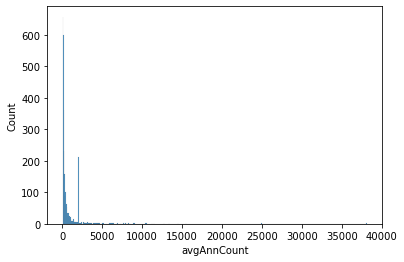

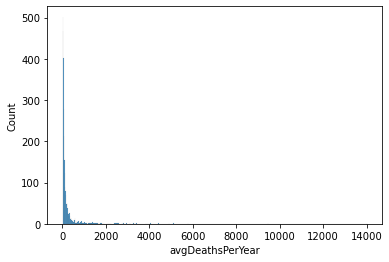

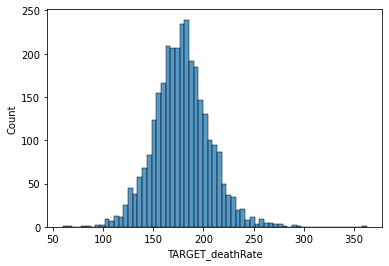

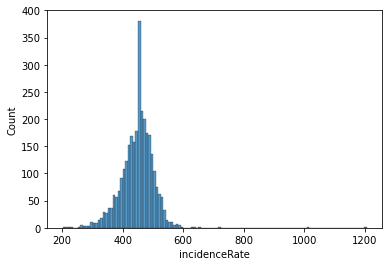

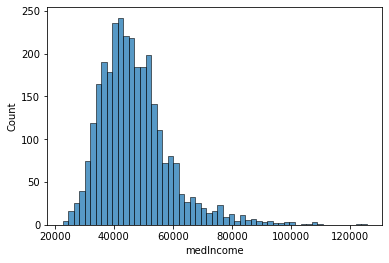

...

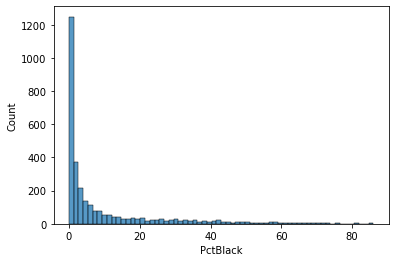

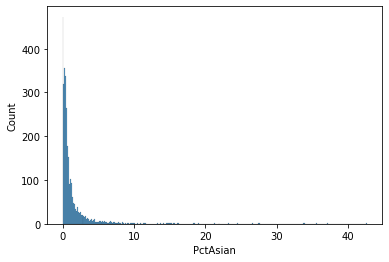

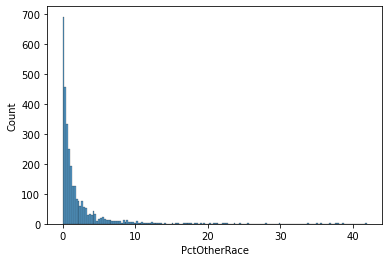

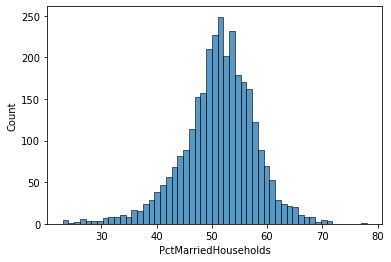

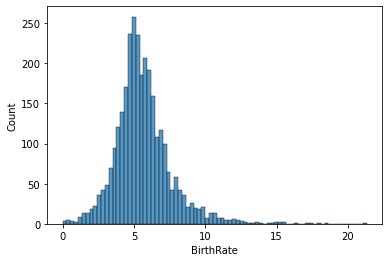

/Users/mariam/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 131 (\x83) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/mariam/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 130 (\x82) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


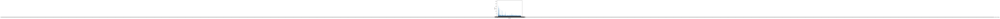

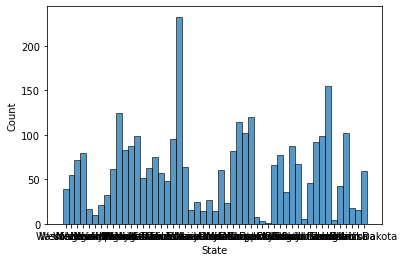

In [12]:
columns = cancer_data.columns

for col in columns:
    sns.histplot(data= cancer_data, x=col)
    plt.show()

The data appears to follow a normal distribution. However, skwedness appears when examining the following variables:
- avgAnnCount: Mean number of reported cases of cancer diagnosed annually(a)
- avgDeathsPerYear: Mean number of reported mortalities due to cancer(a)
- incidenceRate
- studyPerCap
- ethnicity
- educational attainment

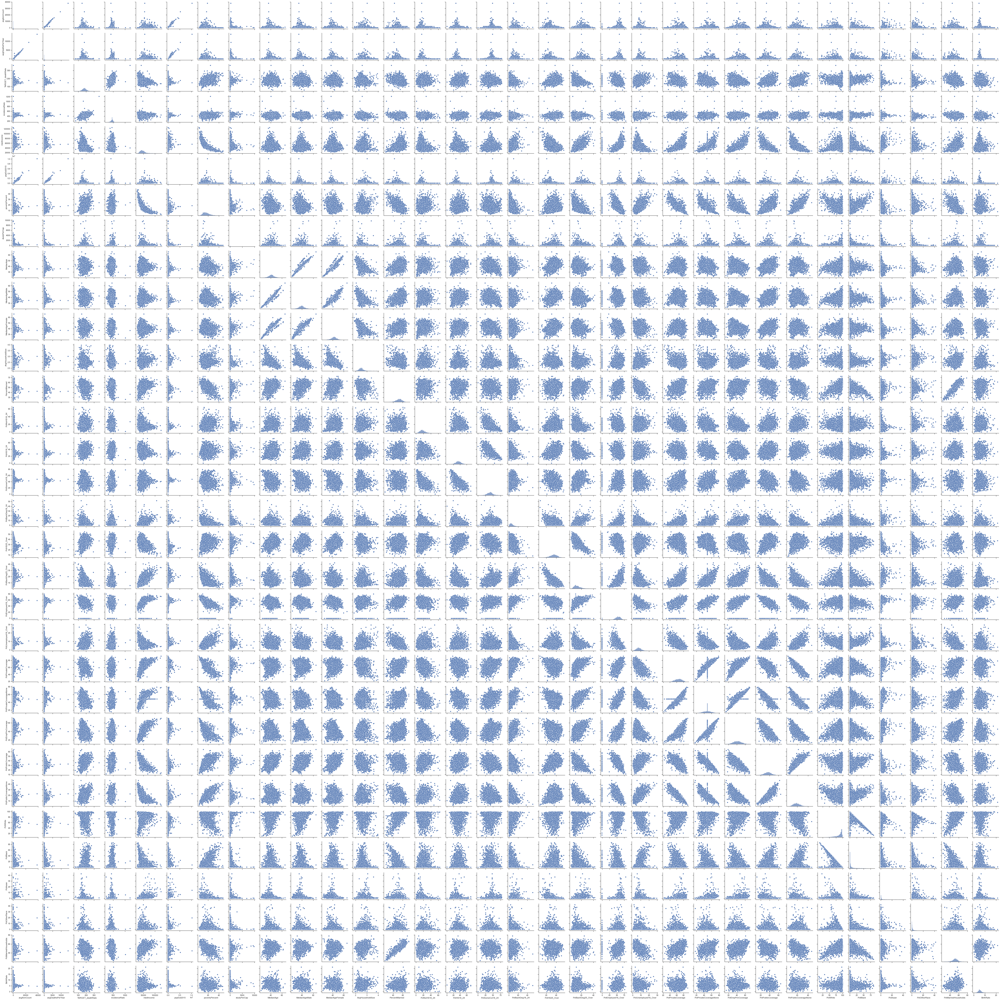

In [19]:
#Draw a matrix scatterplot

sns.set_theme(style='ticks')
#df = sns.load_dataset('cancer_data')
sns.pairplot(cancer_data)
plt.show()

<AxesSubplot:xlabel='PctEmpPrivCoverage', ylabel='avgDeathsPerYear'>

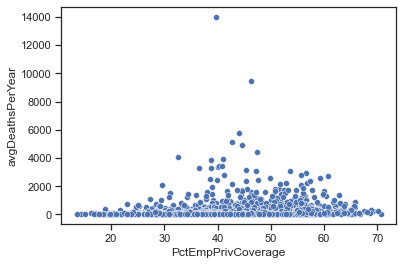

In [23]:
#Plot for each indivual variable for more clarity
sns.scatterplot(data=cancer_data, x='PctEmpPrivCoverage', y='avgDeathsPerYear')

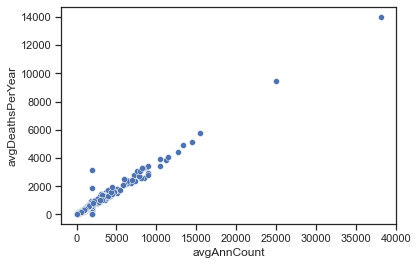

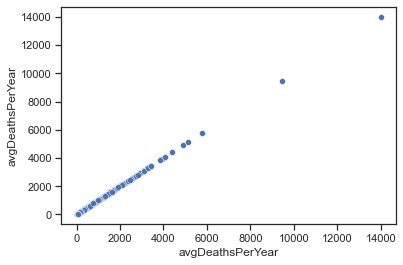

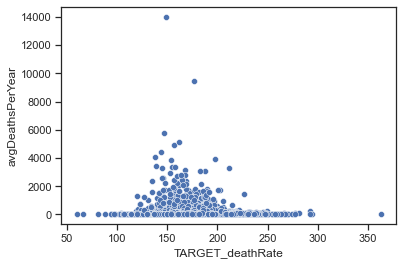

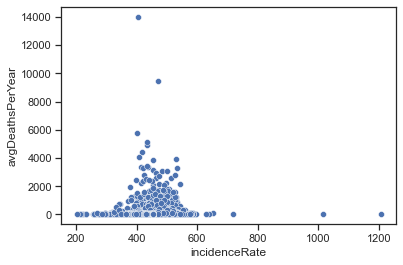

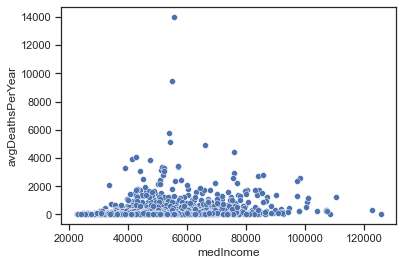

...

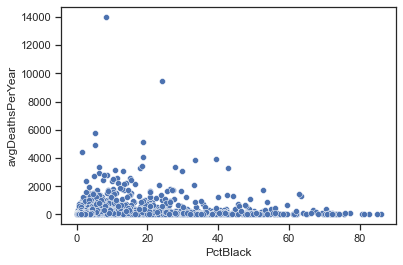

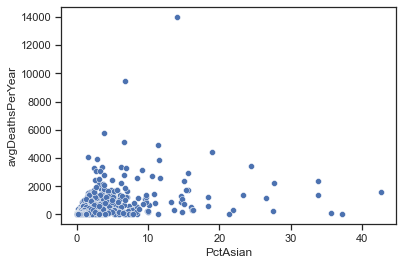

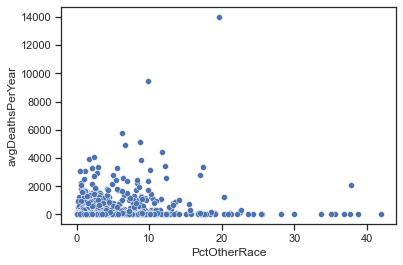

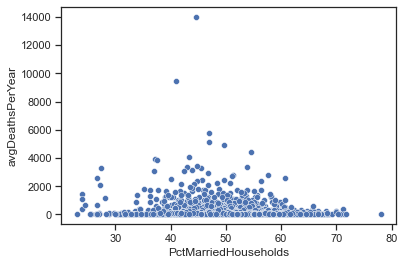

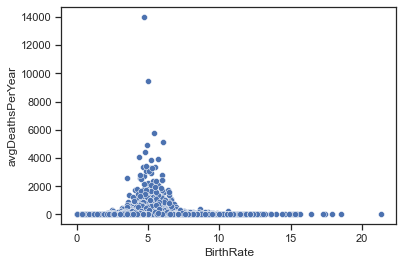

/Users/mariam/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 131 (\x83) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/mariam/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 130 (\x82) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


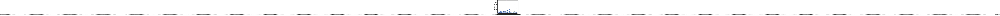

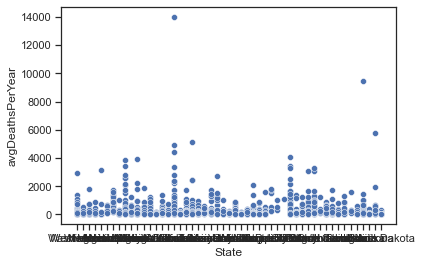

In [24]:
#Plot for each indivual variable for more clarity
for col in columns:
    sns.scatterplot(data=cancer_data, x=col, y='avgDeathsPerYear')
    plt.show()

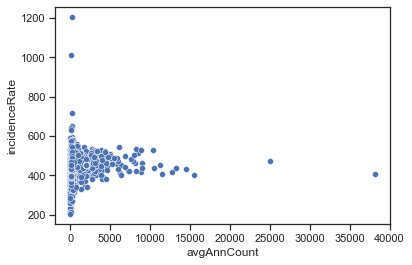

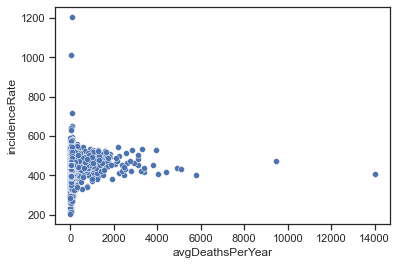

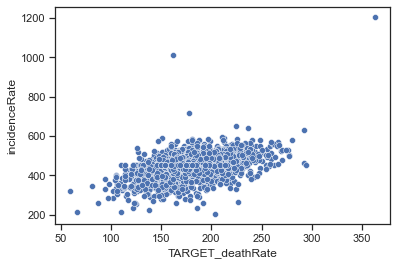

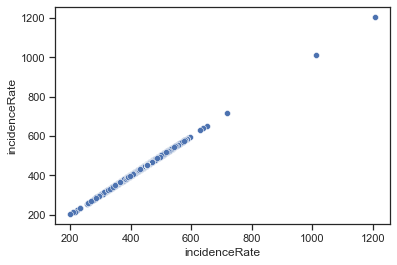

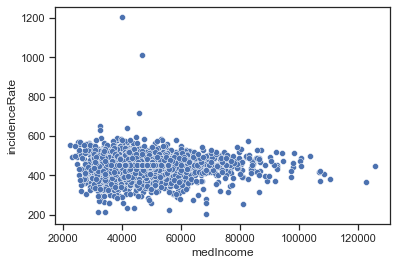

...

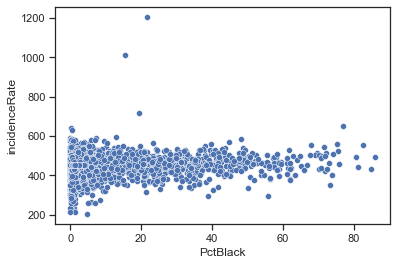

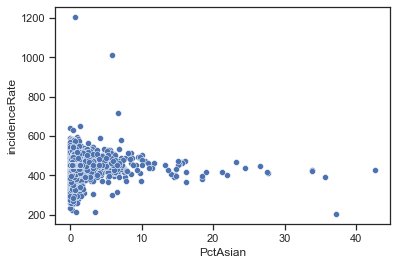

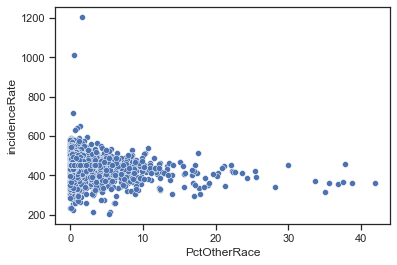

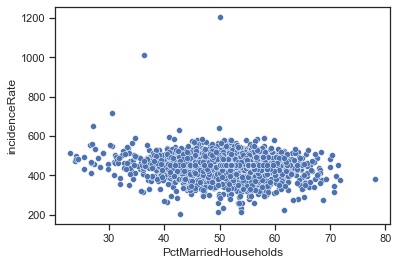

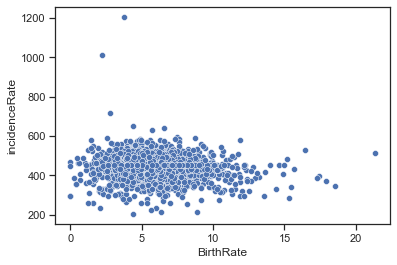

/Users/mariam/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 131 (\x83) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/mariam/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 130 (\x82) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


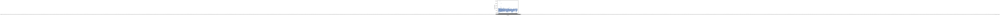

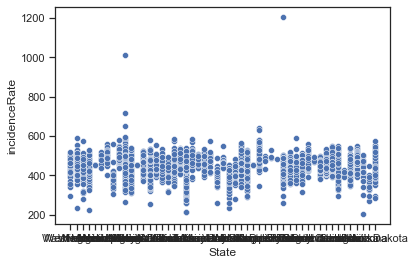

In [26]:
#Plot for each indivual variable for more clarity
for col in columns:
    sns.scatterplot(data=cancer_data, x=col, y='incidenceRate')
    plt.show()

In [4]:
from bokeh.plotting import figure, output_notebook, show
from bokeh.models import ColumnDataSource
from bokeh.layouts import gridplot
import pandas as pd

# Load your dataset (assuming 'cancer_data' is your DataFrame)
# df = pd.read_csv('path_to_your_data.csv')

# Assuming 'cancer_data' is your DataFrame
source = ColumnDataSource(cancer_data)

# Create scatterplot matrix
scatterplots = []
variables = list(cancer_data.columns)

for i, var1 in enumerate(variables):
    for j, var2 in enumerate(variables):
        p = figure(title=f"{var1} vs {var2}", plot_width=300, plot_height=300)
        p.circle(var1, var2, source=source)
        
        # Remove unnecessary axes
        if i != 0:
            p.xaxis.visible = False
        if j != 0:
            p.yaxis.visible = False
        
        scatterplots.append(p)

# Arrange scatterplots in a grid layout
grid = gridplot(scatterplots, ncols=len(variables), toolbar_location=None)

# Show the plot
output_notebook()
show(grid)

Loading BokehJS ...

## Heatmap to check for correlated features

In [8]:
cancer_data['binnedInc'][0].dtypes

AttributeError: 'str' object has no attribute 'dtypes'

In [5]:
#Plot heatmap

sns.heatmap(cancer_data)

ValueError: could not convert string to float: '(61494.5, 125635]'